
# Vision Transformer (ViT) Architecture — From Fundamentals to Research Frontiers

## 1. Introduction

The **Vision Transformer** (*ViT*) is a deep-learning architecture that adapts the transformer model (originally from NLP) to process visual data. Instead of using convolutional filters to capture **local** spatial patterns like a CNN, the ViT uses **self-attention** across patches of the image to model **global** relationships. ([GeeksforGeeks][1])
ViT has demonstrated strong performance in tasks such as image classification, object detection, segmentation, and more.

**Recommended background**

* Basics of convolutional neural networks (CNNs)
* Understanding self-attention and transformer architectures
* Knowledge of how images can be represented as patches or grids
* Basic embedding and positional encoding concepts


## 2. The Big Picture

ViT borrows its structure from the transformer architecture introduced in “Attention Is All You Need” (2017). Instead of treating an image as a 2D grid of pixels, ViT cuts it into a **sequence of patches**, similar to tokens in a sentence, then applies a transformer encoder to that sequence. ([GeeksforGeeks][1])

The architecture can be broken down into four key stages:

1. Patch splitting + embedding
2. Positional encoding
3. Transformer encoder stack
4. Classification head using a **CLS token**

### Illustrative images

![Image](https://media.geeksforgeeks.org/wp-content/uploads/20250108160202257232/Vision-Transformer-Architecture_.webp)

![Image](https://media.geeksforgeeks.org/wp-content/uploads/20250120164009277743/Architecture.webp)

![Image](https://media.geeksforgeeks.org/wp-content/uploads/20250728205619527221/spatio_temporal_transformer_encoder.webp)


## 3. Detailed Architecture

### 3.1 Image Patching & Embedding

* The input image of dimensions (H \times W \times C) is divided into non-overlapping patches of size (P \times P). For example, a 224×224 image with P=16 yields (224/16)×(224/16)=14×14=196 patches. ([GeeksforGeeks][1])
* Each patch of size (P \times P \times C) is then flattened into a 1-D vector of size (P^2 \times C).
* A learnable linear projection (fully connected layer) transforms each flattened patch into an embedding vector of dimension D.
* The total number of patch embeddings is (N = \frac{H}{P} \times \frac{W}{P}).
* A special **CLS token** (classification token) is prepended to the sequence of embeddings so that the model can attend across all patches and derive a global image representation.

### 3.2 Positional Encoding

Since transformers do not natively encode spatial relationships (they treat tokens as unordered sequences), positional embeddings are added to each patch embedding (and to the CLS token). These can either be learned (trained) or fixed (pre-computed). The purpose is to inform the model of the spatial location of each patch within the original image. ([GeeksforGeeks][1])

### 3.3 Transformer Encoder Stack

The sequence (CLS token + patch embeddings + positional embeddings) is passed through a stack of L identical transformer encoder layers. Each layer typically consists of:

* **Multi-Head Self-Attention (MHSA)**: For each token in the sequence, queries (Q), keys (K), and values (V) are computed; attention weights reflect the pair-wise relation between tokens, enabling global context modelling.
* **Feed-Forward Network (FFN)**: Usually two fully connected layers separated by a non-linear activation (often GELU).
* **Residual (skip) connections** and **Layer Normalization** for stability and improved gradient flow.

By stacking multiple layers (e.g., 12, 24), the model gradually refines representations: from raw patch embeddings to high-level semantic embeddings capturing image-wide context.

### 3.4 Classification Head

After the final encoder layer, the embedding corresponding to the CLS token is extracted (it has aggregated information across all patches). This embedding is passed through a small MLP (typically 1-2 dense layers + softmax) to produce class probabilities. The CLS token thus serves as the global image representation.

### 3.5 Additional Elements from GfG

From the GeeksforGeeks exposition:

* The article emphasises that ViT treats image patches **as tokens** (drawing an explicit analogy to words in NLP). ([GeeksforGeeks][2])
* It highlights the significance of **learned vs fixed positional embeddings** and how they affect model behaviour.
* It reiterates the four main stages (patch embedding → positional encoding → transformer encoder → classification head) as a clear workflow. ([GeeksforGeeks][1])


## 4. Summary Table

| Stage                       | Role                                                   |
| --------------------------- | ------------------------------------------------------ |
| Patch splitting & embedding | Convert image to a sequence of token embeddings        |
| Positional encoding         | Provide spatial-location information to the model      |
| Transformer encoder stack   | Model global relationships among patches via attention |
| Classification head         | Use CLS token to produce final prediction              |


## 5. ViT vs CNN – Key Contrasts

Here is a comparative view of ViTs and traditional CNNs:

| Feature                   | CNNs                                      | ViTs                                          |
| ------------------------- | ----------------------------------------- | --------------------------------------------- |
| Patterns captured         | Local textures and features               | Long-range/global relationships               |
| Built-in inductive biases | Strong (locality, translation invariance) | Minimal; more reliance on data                |
| Data requirement          | Often modest datasets suffice             | Usually need large datasets/pretraining       |
| Scalability               | Scales but with more constrained growth   | Scales very well with large data & model size |
| Computation & complexity  | Efficient local operations                | Self-attention is heavier for many tokens     |

In short: CNNs are specialists with strong inductive biases; ViTs are generalists with high flexibility — but they often need “training wheels” (lots of data & compute) to shine.


## 6. Strengths & Challenges

### Strengths

* Excellent at capturing **global context** within an image
* Flexible: can adapt to many vision tasks (classification, detection, segmentation)
* Scalable: large models and big datasets lead to strong performance

### Challenges

* High **data demand**: without large scale training, performance may lag
* Higher **compute cost**: self-attention grows quadratically with number of tokens
* Fewer embedded biases: For small datasets or limited compute, CNNs might still outperform
* Hyper-parameters matter: patch size, embedding dimension, positional encoding choice all strongly impact performance (as per GfG)


## 7. Research-Oriented Expansion

### 7.1 Variants & Innovations

* **Hybrid CNN-Transformer Models**: These inject convolutional operations into the ViT pipeline to capture local structures better.
* **Hierarchical / Multi-Scale ViTs**: Instead of one fixed patch size, these designs use multiple patch scales or token merging/splitting to capture fine and coarse features.
* **Efficient / Lightweight ViTs**: Research on reducing compute via token pruning, sparse attention, quantisation, distillation.
* **Beyond Classification**: Use of ViTs for video (spatio-temporal patches), 3D/point-cloud vision, multimodal (vision+text) tasks.
* GeeksforGeeks article on the “Convolutional Vision Transformer (CvT)” is a good example of combining convolutional stems with transformer backbones. ([arXiv][3])

### 7.2 Open Challenges

* How to train ViTs **effectively on small datasets** (data-efficiency)
* How to embed useful **inductive biases** (locality, hierarchy) into transformer-based vision models
* Can self-attention be made **more efficient** for high resolution inputs?
* How do ViTs behave under **domain shift**, adversarial conditions, or limited labels?
* How to interpret attention maps meaningfully in vision context?
* How to design **adaptive patch/tokenization** schemes (learned patches, overlapping patches)?
* Considering **energy efficiency**, especially for large-scale models and real-world deployment

### 7.3 Future Directions

* Unified architectures for **vision + language + other modalities** using ViT-style backbones
* **Adaptive tokenisation** where patches are content-aware rather than fixed grid
* **Edge-optimized ViTs** for mobile/IoT deployment
* Domain-specific ViTs tailored for medical imaging, remote sensing, scientific imagery
* Deeper **theoretical understanding** of why and when ViTs outperform CNNs


## 8. Detailed Example: Walk-through & Code Sketch

### 8.1 Architecture Walk-through

1. Input: image of 224×224×3
2. Patch size P=16 → 14×14 = 196 patches
3. Each patch: flatten (16×16×3 = 768) → linear projection → embedding size D (e.g., 768)
4. Add positional embeddings → sequence length = 196 + 1 (including CLS)
5. Pass through L transformer encoder layers (each: MHSA + FFN + residual + LayerNorm)
6. Extract CLS token output → MLP head → softmax → class prediction

### 8.2 Pseudocode (simplified)

```python
class ViT(nn.Module):
    def __init__(self, img_size=224, patch_size=16, in_chans=3, embed_dim=768,
                 depth=12, num_heads=12, mlp_dim=3072, num_classes=1000):
        super().__init__()
        self.patch_size = patch_size
        self.num_patches = (img_size // patch_size) ** 2
        self.patch_embed = nn.Linear(patch_size*patch_size*in_chans, embed_dim)
        self.cls_token = nn.Parameter(torch.zeros(1, 1, embed_dim))
        self.pos_embed = nn.Parameter(torch.zeros(1, self.num_patches+1, embed_dim))
        self.transformer = nn.ModuleList([
            TransformerEncoderLayer(embed_dim, num_heads, mlp_dim)
            for _ in range(depth)
        ])
        self.norm = nn.LayerNorm(embed_dim)
        self.head = nn.Linear(embed_dim, num_classes)

    def forward(self, x):
        # x shape: (batch_size, in_chans, img_size, img_size)
        patches = x.unfold(2, self.patch_size, self.patch_size)\
                    .unfold(3, self.patch_size, self.patch_size)
        patches = patches.contiguous().view(x.size(0), self.num_patches, -1)
        x = self.patch_embed(patches)
        cls_tokens = self.cls_token.expand(x.size(0), -1, -1)
        x = torch.cat((cls_tokens, x), dim=1)
        x = x + self.pos_embed
        for layer in self.transformer:
            x = layer(x)
        x = self.norm(x)
        cls_out = x[:, 0]
        logits = self.head(cls_out)
        return logits
```

### 8.3 Training & Practical Tips

* Pre-training on large datasets (e.g., ImageNet-21k) greatly helps ViTs.
* Strong data augmentation and proper regularisation (dropout, stochastic depth) are beneficial.
* Patch size matters: smaller patch → finer spatial resolution, but more tokens → higher compute.
* If fine-tuning on a different resolution, positional embeddings may need interpolation.
* On smaller datasets, hybrid CNN+ViT models may perform better than pure ViTs from scratch.
* Choose positional encoding scheme (learned vs fixed) carefully — it can influence performance.

## 9. Summary & Key Takeaways

* ViTs bring a new paradigm: treating images as sequences of patches and applying transformer encoders for vision tasks.
* They excel at modelling global context, offer flexibility across many vision tasks, and scale well with large datasets and models.
* Their disadvantages include heavy data/computation requirements and lower performance on small datasets unless properly engineered.
* Many innovations (hybrid models, efficient designs, new tokenisation schemes) are actively pushing the frontier.
* For your journey in vision research or applications, understanding ViTs is essential — both their mechanics and their research directions.


## 10. Further Reading & Resources

* Dosovitskiy et al., *An Image is Worth 16×16 Words: Transformers for Image Recognition at Scale* (ICLR 2021)
* GeeksforGeeks: “Vision Transformer (ViT) Architecture” article for step-by-step explanations. ([GeeksforGeeks][1])
* Survey articles: “Transformers in Vision” and “Efficient Vision Transformers: Algorithms, Techniques, and Performance Benchmarking”
* Tutorials & code repos covering ViT implementation, fine-tuning, domain adaptation


[1]: https://www.geeksforgeeks.org/deep-learning/vision-transformer-vit-architecture/?utm_source=chatgpt.com "Vision Transformer (ViT) Architecture - GeeksforGeeks"
[2]: https://www.geeksforgeeks.org/vision-transformer-in-computer-vision/?utm_source=chatgpt.com "Vision Transformer in Computer Vision | GeeksforGeeks"
[3]: https://arxiv.org/abs/2103.15808?utm_source=chatgpt.com "CvT: Introducing Convolutions to Vision Transformers"


# Vision Transformer (from scratch) on Galaxy10 (GZ10 / DECaLS)

In this demo, we implemented and trained a compact Vision Transformer architecture from scratch on the Galaxy10 dataset. After preparing the data and organizing it into batches, the model learned to classify galaxy morphologies by iteratively adjusting its parameters based on prediction errors. Each training epoch processed all images once, while a validation phase measured performance on unseen examples to monitor generalization. We used a straightforward training loop with a cross-entropy loss function and the AdamW optimizer, and we tracked metrics such as accuracy and loss throughout training. This provided a complete hands-on demonstration.

**Live demo**: Patch → Embedding → Positional Encoding → Transformer Encoder → CLS → Prediction  
**Visuals**: Patch reveal animation + Attention rollout animation  
**Audience**: Newcomers to ViT, with step-by-step comments

- Dataset: Galaxy10 DECaLS (≈17,736 images, 256×256, 10 classes)
- Source: Zenodo HDF5, documented by astroNN
- This notebook **implements ViT end-to-end from scratch** (no timm/HF).

> Tips for class: use the `SMALL_DEMO` switch and `EPOCHS=2–5` to keep it snappy.

pip install einops matplotlib

The next cell prepares the training environment:

✔ Checks if a GPU is available
✔ Imports all required libraries
✔ Sets a reproducible random seed
✔ Chooses CPU or GPU for computations

In [35]:
#@title ⛳ Setup: GPU + minimal installs
!nvidia-smi -L || echo "No GPU detected (will run, but slower)"

# Minimal libraries: Hugging Face Datasets, vision utils, metrics, animations
# pip -q install datasets huggingface_hub pyarrow einops matplotlib opencv-python scikit-learn

import os, math, random, io
import numpy as np
from pathlib import Path
from tqdm import tqdm
from einops import rearrange
import matplotlib.pyplot as plt
from matplotlib import animation
import cv2

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset as TorchDataset, DataLoader
from torchvision import transforms

from datasets import load_dataset, DatasetDict

SEED = 42
random.seed(SEED); np.random.seed(SEED)
torch.manual_seed(SEED); torch.cuda.manual_seed_all(SEED)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device


GPU 0: NVIDIA A100-PCIE-40GB (UUID: GPU-40305a5a-4a3b-9237-9adf-da80e7460dd5)


device(type='cuda')

## Loading the GZ10 dataset from Hugging Face

We use the dataset:
**`MultimodalUniverse/gz10`** — also known as **Galaxy10 DECaLS**.

It contains:

* `rgb_image`: a **galaxy image** (3-channel RGB format)
* `gz10_label`: integer from **0 to 9** → galaxy morphology class
  (10 total categories)

### What this code does step-by-step

1️⃣ Try to load **three standard splits** if they exist:

* `train`
* `validation`
* `test`

Different datasets may provide different splits, so we check what is available.

2️⃣ If only a `train` split exists:

* We **create a validation and test set automatically**
* Using an **80% / 10% / 10%** split of the training data

This helps us always keep:

* A part to **train**
* A part to **validate during training**
* A part to **test final performance** fairly

3️⃣ We print:

* The splits found/created
* The number of samples in each split

4️⃣ We display:

* The **dataset structure**
* The **feature types** (images, labels, etc.)
* One **sample dictionary** to understand how to access the data


In [36]:
#@title Load dataset from Hugging Face: MultimodalUniverse/gz10
# Expected fields: 'rgb_image' (RGB image) and 'gz10_label' (int in [0..9]).
# If only 'train' exists, we will create 'validation' and 'test' splits.

DS_NAME = "MultimodalUniverse/gz10"

try:
    ds = DatasetDict()
    for sp in ["train", "validation", "test"]:
        try:
            ds[sp] = load_dataset(DS_NAME, split=sp)
            print(f"✅ Loaded split {sp}: {len(ds[sp])} samples")
        except Exception as e:
            print(f"ℹ️ Split '{sp}' unavailable ({e})")

    if "train" not in ds:
        ds["train"] = load_dataset(DS_NAME, split="train")
        print(f"✅ Fallback 'train': {len(ds['train'])} samples")

    # Create val/test if missing
    if "validation" not in ds or "test" not in ds:
        print("🔧 Creating validation/test from train (80/10/10)")
        tmp = ds["train"].train_test_split(test_size=0.2, seed=SEED)
        val_test = tmp["test"].train_test_split(test_size=0.5, seed=SEED)
        ds = DatasetDict({
            "train": tmp["train"],
            "validation": val_test["train"],
            "test": val_test["test"],
        })
    print({k: len(v) for k,v in ds.items()})
except Exception as e:
    raise RuntimeError("Failed to load HF dataset") from e

# Inspect features and a sample
for sp in ds:
    print(f"\n=== {sp} features ===")
    print(ds[sp].features)
    ex = ds[sp][0]
    print("Example keys:", list(ex.keys()))


✅ Loaded split train: 17736 samples
ℹ️ Split 'validation' unavailable (Unknown split "validation". Should be one of ['train'].)
ℹ️ Split 'test' unavailable (Unknown split "test". Should be one of ['train'].)
🔧 Creating validation/test from train (80/10/10)
{'train': 14188, 'validation': 1774, 'test': 1774}

=== train features ===
{'gz10_label': Value('int32'), 'redshift': Value('float32'), 'object_id': Value('string'), 'rgb_image': Image(mode=None, decode=True), 'rgb_pixel_scale': Value('float32')}
Example keys: ['gz10_label', 'redshift', 'object_id', 'rgb_image', 'rgb_pixel_scale']

=== validation features ===
{'gz10_label': Value('int32'), 'redshift': Value('float32'), 'object_id': Value('string'), 'rgb_image': Image(mode=None, decode=True), 'rgb_pixel_scale': Value('float32')}
Example keys: ['gz10_label', 'redshift', 'object_id', 'rgb_image', 'rgb_pixel_scale']

=== test features ===
{'gz10_label': Value('int32'), 'redshift': Value('float32'), 'object_id': Value('string'), 'rgb_imag

## Wrapping a Hugging Face dataset as a PyTorch dataset

Hugging Face (`datasets`) and PyTorch (`torch.utils.data`) use **different formats** for handling images and batches.

So we build a **wrapper class** that:

- Finds automatically which column contains the **images**
- Finds automatically which column contains the **labels**
- Converts Hugging Face examples into PyTorch format
- Applies image transforms (resize, augmentation…)
- Supports taking a **subset** of the dataset (useful for demos)

#### 1️⃣ Candidate column names

```python
IMG_CANDIDATES = ["rgb_image", "image", "img", "image_rgb"]
LBL_CANDIDATES = ["gz10_label", "label", "labels", "class"]
```

Different datasets use different column names.
We keep a **list of possibilities** and check what exists.


#### 2️⃣ Detect the image + label columns

```python
def _detect_columns(hf_ds):
    cols = list(hf_ds.features.keys())
    img_col = next((c for c in IMG_CANDIDATES if c in cols), None)
    lbl_col = next((c for c in LBL_CANDIDATES if c in cols), None)
    ...
```

We search through candidates and pick the **first matching** one.
If nothing matches → we raise a helpful error.

We hope this makes the wrapper **robust** if dataset format changes slightly.


#### 3️⃣ Convert an image into a standard NumPy array

```python
def _to_numpy_img(x):
    if PIL image → convert to ndarray
    if grayscale → duplicate channels to create RGB
```
→ PyTorch transforms expect NumPy or Tensor format.
We normalize everything to **HxWx3** (RGB).

#### 4️⃣ The actual dataset wrapper class

```python
class HFVisionTorchDataset(TorchDataset):
```

This object behaves like a **PyTorch Dataset** ✅

It stores:

* the Hugging Face dataset
* the index subset we want to load
* the transform function (if provided)

##### `__init__`

* Detect columns
* Optionally restrict dataset size (for demos)

  ```python
  take=256 → only first 256 random samples
  ```
* Store transforms

##### `__len__`

Returns the **number of examples** → required by PyTorch

##### `__getitem__`

Called every time a sample is needed:

* Load the correct example
* Convert image format
* Apply transforms
* Return `(image, label)` pair

## Result

After defining this wrapper, we can write:

```python
train_ds = HFVisionTorchDataset(ds["train"], transform=train_tf)
train_loader = DataLoader(train_ds, batch_size=32, shuffle=True)
```

Now the **Hugging Face dataset behaves exactly like a standard PyTorch dataset**.


In [37]:
#@title 🧩 PyTorch dataset wrapper (auto-detects image/label columns)
# Robust to variations: tries common field names.
IMG_CANDIDATES = ["rgb_image", "image", "img", "image_rgb"]
LBL_CANDIDATES = ["gz10_label", "label", "labels", "class"]

def _detect_columns(hf_ds):
    cols = list(hf_ds.features.keys())
    img_col = next((c for c in IMG_CANDIDATES if c in cols), None)
    lbl_col = next((c for c in LBL_CANDIDATES if c in cols), None)
    if img_col is None or lbl_col is None:
        raise KeyError(
            f"Could not find image/label columns. Available={cols}\n"
            f"Looked for image∈{IMG_CANDIDATES}, label∈{LBL_CANDIDATES}"
        )
    return img_col, lbl_col

def _to_numpy_img(x):
    # Accept PIL.Image, list, ndarray → return HxWx3 ndarray
    if hasattr(x, "size") and hasattr(x, "mode"):   # PIL
        return np.array(x)
    x = np.asarray(x)
    if x.ndim == 2:  # grayscale fallback → RGB
        x = np.stack([x, x, x], axis=-1)
    return x

class HFVisionTorchDataset(TorchDataset):
    def __init__(self, hf_ds, transform=None, take=None, seed=42):
        self.ds = hf_ds
        self.img_col, self.lbl_col = _detect_columns(hf_ds)
        idx = np.arange(len(hf_ds))
        if take is not None and take < len(idx):
            rng = np.random.default_rng(seed)
            idx = rng.choice(idx, size=take, replace=False)
        self.indices = idx
        self.transform = transform

    def __len__(self): 
        return len(self.indices)

    def __getitem__(self, i):
        ex = self.ds[int(self.indices[i])]
        img = _to_numpy_img(ex[self.img_col])
        y = int(ex[self.lbl_col])
        if self.transform:
            img = self.transform(img)
        return img, y


## Image Transforms & DataLoaders (with optional quick-demo mode)

Before training a model, we must **prepare the images** and **organize them** into batches.
This block handles four important tasks:

- Resize images to **224×224** (expected by Vision Transformers)
- Convert to PyTorch tensors and normalize pixel values
- Create a **subset mode** for fast demos
- Wrap data into **DataLoaders** for efficient training

### 1️⃣ Input size and training settings

```python
IMG_SIZE   = 224    # ViT input size
PATCH_SIZE = 16     # affects number of tokens inside ViT
BATCH_SIZE = 32
SMALL_DEMO = True   # True = subsample for faster live demo
```

✔ Vision Transformers such as ViT-Base expect **224×224 RGB** images
✔ A patch size of 16 means the image becomes **14×14 = 196 tokens**
✔ `SMALL_DEMO` can drastically reduce run-time on CPU or small GPUs


### 2️⃣ Image transforms (preprocessing)

```python
normalize = transforms.Normalize(mean=(0.5,0.5,0.5), std=(0.5,0.5,0.5))
tf_train = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((IMG_SIZE, IMG_SIZE), antialias=True),
    transforms.RandomHorizontalFlip(),
    normalize,
])
tf_val = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((IMG_SIZE, IMG_SIZE), antialias=True),
    normalize,
])
```

Each image goes through:

| Step                                  | Why                                                    |
| ------------------------------------- | ------------------------------------------------------ |
| Convert to tensor                     | PyTorch models need tensors, not PIL images            |
| Resize to 224×224                     | Required by ViT input layer                            |
| Random horizontal flip *(train only)* | Helps generalization                                   |
| Normalization                         | Keeps pixel values in similar ranges → faster learning |


### 3️⃣ Galaxy class names (optional)

```python
CLASSES = [
   "Disturbed", "Merging", "Round Smooth", ...
]
```

This list maps class index → readable label
Useful for evaluation and visualization

### 4️⃣ Faster training during live demo

```python
def take_for_demo(hf_split, max_n):
    if not SMALL_DEMO: return None
    return min(max_n, len(hf_split)) if len(hf_split) > max_n else None
```

When `SMALL_DEMO=True`, we **limit the dataset size**:

| Split | Max samples |
| ----- | ----------- |
| Train | 8000        |
| Val   | 2000        |
| Test  | 2000        |

- Much faster training for class exercises
- People see results quickly 
- Easier debugging


### 5️⃣ Create PyTorch datasets using our wrapper

```python
train_ds = HFVisionTorchDataset(ds["train"], transform=tf_train, take=take_train)
val_ds   = HFVisionTorchDataset(ds["validation"], transform=tf_val, take=take_val)
test_ds  = HFVisionTorchDataset(ds["test"], transform=tf_val, take=take_test)
```

Thanks to the wrapper, we now get `(tensor_image, label)` pairs just like a standard PyTorch dataset ✅

### 6️⃣ Create DataLoaders

```python
train_dl = DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True,  num_workers=2, pin_memory=True)
val_dl   = DataLoader(val_ds,   batch_size=BATCH_SIZE, shuffle=False, num_workers=2, pin_memory=True)
test_dl  = DataLoader(test_ds,  batch_size=BATCH_SIZE, shuffle=False, num_workers=2, pin_memory=True)
```

DataLoaders:

* Group samples in batches
* Shuffle training data
* Load in parallel (`num_workers=2`)
* Speed up GPU transfers (`pin_memory=True`)


### What this gives us

A clean structure powering your training loop:

```python
for images, labels in train_dl:
    ...
```

Everything is now ready to:

* Feed batches into the Vision Transformer
* Train efficiently on GPU or CPU
* Evaluate smoothy on validation & test sets 


In [38]:
#@title 🔧 Transforms & DataLoaders (with quick-demo mode)
IMG_SIZE   = 224    # ViT input size
PATCH_SIZE = 16     # 16x16 → 14x14 = 196 tokens at 224x224
BATCH_SIZE = 32
SMALL_DEMO = True   # True = subsample for faster live demo

# Simple, beginner-friendly normalization for visibility
normalize = transforms.Normalize(mean=(0.5,0.5,0.5), std=(0.5,0.5,0.5))
tf_train = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((IMG_SIZE, IMG_SIZE), antialias=True),
    transforms.RandomHorizontalFlip(),
    normalize,
])
tf_val = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((IMG_SIZE, IMG_SIZE), antialias=True),
    normalize,
])

# Class names for Galaxy10
CLASSES = [
    "Disturbed", "Merging", "Round Smooth", "Cigar Shaped Smooth", "Barred Spiral",
    "Unbarred Tight Spiral", "Unbarred Loose Spiral", "Edge-on w/ Bulge",
    "Edge-on w/o Bulge", "Irregular"
]

def take_for_demo(hf_split, max_n):
    if not SMALL_DEMO: return None
    return min(max_n, len(hf_split)) if len(hf_split) > max_n else None

take_train = take_for_demo(ds["train"], 8000)
take_val   = take_for_demo(ds["validation"], 2000)
take_test  = take_for_demo(ds["test"], 2000)

train_ds = HFVisionTorchDataset(ds["train"], transform=tf_train, take=take_train)
val_ds   = HFVisionTorchDataset(ds["validation"], transform=tf_val, take=take_val)
test_ds  = HFVisionTorchDataset(ds["test"], transform=tf_val, take=take_test)

train_dl = DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True,  num_workers=2, pin_memory=True)
val_dl   = DataLoader(val_ds,   batch_size=BATCH_SIZE, shuffle=False, num_workers=2, pin_memory=True)
test_dl  = DataLoader(test_ds,  batch_size=BATCH_SIZE, shuffle=False, num_workers=2, pin_memory=True)

len(train_ds), len(val_ds), len(test_ds)


(8000, 1774, 1774)

## Quick Visual Sanity Check

Before training the model, it’s a good idea to:

* **Look at some images**
* Check that **labels match what we see**
* Confirm that **transforms were applied correctly**
  (resize, flip, normalization…)

This function displays a **random mini-grid** of galaxies from the dataset.

### What this function does step-by-step:

#### 1️⃣ Pick some random samples

```python
idxs = np.random.choice(len(ds_torch), ...)
xs, ys = zip(*[ds_torch[i] for i in idxs])
```

We randomly select images from the dataset wrapper and extract:

* `xs`: image tensors
* `ys`: integer class labels

#### 2️⃣ Stack all selected images into a batch

```python
xs = torch.stack(xs)
```

Easy to process and visualize multiple images at once.


#### 3️⃣ Reverse normalization before display

```python
inv = transforms.Normalize(mean=[-1,-1,-1], std=[2,2,2])
```

Our model uses preprocessing:

[
x_{norm} = \frac{x - 0.5}{0.5}
]

Here we **invert it** so we can see normal colors again 😊


#### 4️⃣ Create a row of subplots

```python
fig, axes = plt.subplots(1, len(idxs), figsize=(...))
```

One subplot per sampled galaxy.


#### 5️⃣ Convert tensor → NumPy image and display

```python
ax.imshow((inv(xs[i]).permute(1,2,0).clamp(0,1)).numpy())
```

What happens here:

* `permute(1,2,0)` → switch from (C,H,W) to (H,W,C), which matplotlib expects
* `clamp(0,1)` → ensure image colors remain valid
* `imshow()` → display!


#### 6️⃣ Add human-readable class label

```python
ax.set_title(CLASSES[ys[i]])
```

Easy way to verify label correctness ✅

### Result

Running:

```python
show_grid_torch(train_ds, n=6)
```

Will show images like:

| Galaxy | Class                   |
| -------| ----------------------- |
| Spiral | “Unbarred Loose Spiral” |
| Merger | “Merging”               |
| Smooth | “Round Smooth”          |

If labels look inconsistent with the images → something is wrong upstream!



### Code explained line-by-line

```python
def show_grid_torch(ds_torch, n=6):
```

Define a function that will display a grid of `n` galaxy images.


```python
idxs = np.random.choice(len(ds_torch), size=min(n, len(ds_torch)), replace=False)
```

Pick **n random indices** from the dataset
(no repetition, so no duplicates)

```python
xs, ys = zip(*[ds_torch[i] for i in idxs])
```

Extract:

* `xs`: a list of image tensors
* `ys`: their corresponding class labels


```python
xs = torch.stack(xs)
```

Combine the images into a single tensor batch
→ easier to process and visualize

```python
inv = transforms.Normalize(mean=[-1,-1,-1], std=[2,2,2])  # inverse of (x-0.5)/0.5
```

Images were normalized earlier as:
[
x_\text{norm} = (x - 0.5) / 0.5
]
This operation **undoes that normalization** so colors look correct again.


```python
fig, axes = plt.subplots(1, len(idxs), figsize=(2.2*len(idxs), 2.2))
```

Create a row of subplots → one image per subplot


```python
ax.imshow((inv(xs[i]).permute(1,2,0).clamp(0,1)).numpy())
```

What happens here:

| Operation         | Purpose                                                                                                |
| ----------------- | ------------------------------------------------------------------------------------------------------ |
| `inv(xs[i])`      | undo normalization                                                                                     |
| `.permute(1,2,0)` | convert tensor format from **(channels, height, width)** to **(height, width, channels)** for plotting |
| `.clamp(0,1)`     | keep pixel values valid                                                                                |
| `.numpy()`        | convert tensor → NumPy array for `imshow()`                                                            |

Then we show the image


```python
ax.set_title(CLASSES[ys[i]], fontsize=8)
```

Put the **galaxy class name** above the image
(example: “Spiral”, “Merging”, “Irregular”…)


```python
ax.axis('off')
```

Hide ticks and axes for a cleaner look


```python
plt.show()
```

Display the final gallery of images


### Running the function

```python
show_grid_torch(train_ds, n=6)
```

Produces something like:

```
[Galaxy 1] [Galaxy 2] [Galaxy 3] [Galaxy 4] [Galaxy 5] [Galaxy 6]
   Spiral      Smooth       Merger       Edge-on      ...
```

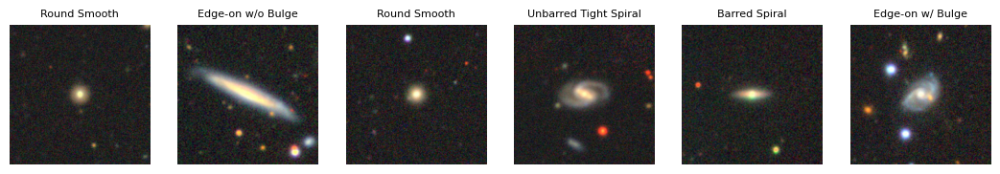

In [39]:
#@title 👀 Quick visual sanity check
def show_grid_torch(ds_torch, n=6):
    idxs = np.random.choice(len(ds_torch), size=min(n, len(ds_torch)), replace=False)
    xs, ys = zip(*[ds_torch[i] for i in idxs])
    xs = torch.stack(xs)
    inv = transforms.Normalize(mean=[-1,-1,-1], std=[2,2,2])  # inverse of (x-0.5)/0.5
    fig, axes = plt.subplots(1, len(idxs), figsize=(2.2*len(idxs), 2.2))
    for i, ax in enumerate(axes):
        ax.imshow((inv(xs[i]).permute(1,2,0).clamp(0,1)).numpy())
        ax.set_title(CLASSES[ys[i]], fontsize=8)
        ax.axis('off')
    plt.show()

show_grid_torch(train_ds, n=6)


## Vision Transformer (ViT) — from scratch, piece by piece

This code builds a small but complete **Vision Transformer** for image classification. The pipeline is:

**Image → Patch embeddings → + [CLS] → + positions → Repeated {MHSA + MLP} blocks → Class head**

Key ideas:

* Treat an image as a **sequence** of patch tokens
* Let tokens talk to each other via **self-attention**
* Keep information stable with **residual connections** and **LayerNorm**


### 1) `PatchEmbed`: image → patch tokens

```python
class PatchEmbed(nn.Module):
    # Image (B,3,H,W) → sequence (B, N, D)
```

* Uses a **Conv2d** with `kernel_size=stride=patch_size` to “unfold” non-overlapping patches and project them to dimension `D` (aka `embed_dim`).
* Shapes:

  * Input: `(B, 3, H, W)`
  * After conv: `(B, D, G, G)` where `G = H/patch = W/patch`
  * Flatten + transpose: `(B, N, D)` where `N = G*G` is the number of patches
* Why a conv? It’s a fast, vectorized way to extract and linearly project patches.


### 2) `PositionalEncoding`: where is each token?

```python
class PositionalEncoding(nn.Module):
    # Learn one embedding per token position (including CLS)
```

* Transformers don’t know order/position by default.
* We learn a matrix `pos` with shape `(1, N+1, D)` and **add** it to the token embeddings so the model can reason about **where** each patch sits.
* The `+1` is for the **[CLS] token** (global summary token used for classification).


### 3) `MultiHeadSelfAttention` (MHSA): tokens talk

```python
class MultiHeadSelfAttention(nn.Module):
    # Standard MHSA; can return attention maps
```

* Projects inputs to **Q, K, V** with a single linear layer, then reshapes to heads.

* Core formula per head:

  [
  \text{Attn}(Q,K,V) = \text{softmax}\left(\frac{Q K^\top}{\sqrt{d_\text{head}}}\right) V
  ]

* Multi-head: split the embedding into `num_heads` chunks so the model learns **different kinds** of relationships in parallel.

* Returns `out` (the attended features). If `return_attn=True`, also returns the attention weights `(B, heads, N, N)` for visualization.

Shapes inside:

* Input `x`: `(B, N, C)`
* `qkv`: `(B, N, 3, H, D_head)` → split to `(q, k, v)`
* Attention matrix: `(B, H, N, N)`
* Output merged back to `(B, N, C)`


### 4) `MLP`: mix features per token

```python
class MLP(nn.Module):
    # Tiny 2-layer MLP with GELU + Dropout
```

* Operates **independently on each token** (position-wise feedforward).
* Expands to `hidden_dim = mlp_ratio * dim`, applies nonlinearity, then projects back to `dim`.
* Helps the model learn richer representations after attention mixes information across tokens.


### 5) `EncoderBlock`: one Transformer layer

```python
class EncoderBlock(nn.Module):
    # LayerNorm → MHSA → residual → LayerNorm → MLP → residual
```

* Two sublayers:

  1. **MHSA** with residual: `x = x + Attn(LN(x))`
  2. **MLP** with residual: `x = x + MLP(LN(x))`
* Residual connections stabilize training and let gradients flow.
* `collect_attn=True` lets you capture attention maps for interpretability.


### 6) `ViT`: assemble the full model

```python
class ViT(nn.Module):
    # PatchEmbed + [CLS] + PositionalEncoding + Blocks + Norm + Head
```

**Init**

* `PatchEmbed`: make tokens from image patches.
* `cls_token`: a learned vector `(1,1,D)` that will summarize the image.
* `pos_embed`: learned positional embeddings for `N + 1` tokens.
* `blocks`: a stack of `depth` encoder blocks.
* `norm` + `head`: final LayerNorm and linear classifier to `num_classes`.

**Forward**

1. `x = PatchEmbed(x)` → `(B, N, D)`
2. Prepend **CLS token**: `x = concat([CLS], x)` → `(B, N+1, D)`
3. Add **positional embeddings** and apply dropout
4. Run through each **EncoderBlock**; collect attention maps if requested
5. Normalize, take the **CLS output** `x[:, 0]`
6. Classifier head → **logits** `(B, num_classes)`

If `return_attn_maps=True`, also return a list of attention tensors to visualize which tokens attend to which.


### Shape cheat-sheet (ViT-Base style)

* Image: `(B, 3, 224, 224)`
* Patch size: `16×16` → grid `14×14` → `N = 196` tokens
* After adding CLS: `N+1 = 197` tokens
* Embedding dim `D` (e.g., 384 here)
* Attention per block: `(B, heads, 197, 197)`


In [ ]:
#@title ViT from-scratch: PatchEmbed, PositionalEncoding, MHSA, MLP, EncoderBlock, ViT
class PatchEmbed(nn.Module):
    """
    Image (B,3,H,W) → sequence of patch embeddings (B, N, D).
    Teaching trick: Conv2d(kernel=stride=patch) 'unfolds' patches and projects to D.
    """
    def __init__(self, in_ch=3, img_size=224, patch_size=16, embed_dim=384):
        super().__init__()
        self.patch = patch_size
        self.grid = img_size // patch_size
        self.num_patches = self.grid * self.grid
        self.proj = nn.Conv2d(in_ch, embed_dim, kernel_size=patch_size, stride=patch_size)

    def forward(self, x):
        # (B,3,H,W) → (B, D, G, G) → (B, D, N) → (B, N, D)
        x = self.proj(x)
        x = x.flatten(2).transpose(1, 2)
        return x

class PositionalEncoding(nn.Module):
    """Learned positional embeddings for N+1 tokens (CLS + patches)."""
    def __init__(self, num_tokens, embed_dim):
        super().__init__()
        self.pos = nn.Parameter(torch.zeros(1, num_tokens, embed_dim))
        nn.init.trunc_normal_(self.pos, std=0.02)
    def forward(self, x):
        return x + self.pos

class MultiHeadSelfAttention(nn.Module):
    """Standard MHSA; optionally returns attention maps for visualization."""
    def __init__(self, dim, num_heads=6, attn_drop=0.0, proj_drop=0.0):
        super().__init__()
        assert dim % num_heads == 0
        self.num_heads = num_heads
        self.head_dim = dim // num_heads
        self.scale = self.head_dim ** -0.5
        self.qkv = nn.Linear(dim, dim*3, bias=True)
        self.attn_drop = nn.Dropout(attn_drop)
        self.proj = nn.Linear(dim, dim)
        self.proj_drop = nn.Dropout(proj_drop)

    def forward(self, x, return_attn=False):
        B, N, C = x.shape
        qkv = self.qkv(x).reshape(B, N, 3, self.num_heads, self.head_dim)
        q, k, v = qkv.unbind(dim=2)  # (B,N,H,D)
        q, k, v = q.transpose(1,2), k.transpose(1,2), v.transpose(1,2)  # (B,H,N,D)
        attn = (q @ k.transpose(-2, -1)) * self.scale         # (B,H,N,N)
        attn = attn.softmax(dim=-1)
        attn = self.attn_drop(attn)
        out = attn @ v                                        # (B,H,N,D)
        out = out.transpose(1,2).reshape(B, N, C)             # (B,N,C)
        out = self.proj_drop(self.proj(out))
        return (out, attn) if return_attn else out

class MLP(nn.Module):
    def __init__(self, dim, hidden_dim, drop=0.0):
        super().__init__()
        self.fc1 = nn.Linear(dim, hidden_dim); self.act = nn.GELU()
        self.fc2 = nn.Linear(hidden_dim, dim); self.drop = nn.Dropout(drop)
    def forward(self, x):
        x = self.drop(self.act(self.fc1(x)))
        x = self.drop(self.fc2(x))
        return x

class EncoderBlock(nn.Module):
    """Encoder block = LN → MHSA → residual → LN → MLP → residual."""
    def __init__(self, dim, num_heads, mlp_ratio=4.0, attn_drop=0.0, drop=0.0):
        super().__init__()
        self.norm1 = nn.LayerNorm(dim)
        self.attn = MultiHeadSelfAttention(dim, num_heads, attn_drop, proj_drop=drop)
        self.norm2 = nn.LayerNorm(dim)
        self.mlp = MLP(dim, int(dim*mlp_ratio), drop)

    def forward(self, x, collect_attn=False):
        if collect_attn:
            a_out, attn = self.attn(self.norm1(x), return_attn=True)
            x = x + a_out
        else:
            x = x + self.attn(self.norm1(x))
            attn = None
        x = x + self.mlp(self.norm2(x))
        return x, attn

class ViT(nn.Module):
    """
    Beginner-friendly, from-scratch Vision Transformer:
    - Conv-based PatchEmbed
    - CLS token
    - Learnable positional embeddings
    - Stack of encoder blocks
    - Classification head (MLP)
    """
    def __init__(self,
                 img_size=224, patch_size=16, in_chans=3,
                 num_classes=10, embed_dim=384, depth=8,
                 num_heads=6, mlp_ratio=4.0, drop=0.1, attn_drop=0.0):
        super().__init__()
        self.patch_embed = PatchEmbed(in_chans, img_size, patch_size, embed_dim)
        self.num_patches = self.patch_embed.num_patches

        self.cls_token = nn.Parameter(torch.zeros(1, 1, embed_dim))
        nn.init.trunc_normal_(self.cls_token, std=0.02)

        self.pos_embed = PositionalEncoding(self.num_patches+1, embed_dim)
        self.pos_drop = nn.Dropout(drop)

        self.blocks = nn.ModuleList([
            EncoderBlock(embed_dim, num_heads, mlp_ratio, attn_drop, drop)
            for _ in range(depth)
        ])
        self.norm = nn.LayerNorm(embed_dim)
        self.head = nn.Linear(embed_dim, num_classes)

    def forward(self, x, return_attn_maps=False):
        B = x.size(0)
        x = self.patch_embed(x)                       # (B, N, D)
        cls = self.cls_token.expand(B, -1, -1)       # (B, 1, D)
        x = torch.cat([cls, x], dim=1)               # (B, N+1, D)
        x = self.pos_drop(self.pos_embed(x))

        attn_maps = []
        for blk in self.blocks:
            x, attn = blk(x, collect_attn=return_attn_maps)
            if return_attn_maps and attn is not None:
                attn_maps.append(attn)               # (B, heads, T, T)

        x = self.norm(x)
        cls_out = x[:, 0]
        logits = self.head(cls_out)
        return (logits, attn_maps) if return_attn_maps else logits


## Training our Vision Transformer (ViT)

Now that we have:

* A **dataset**
* A **ViT model** built from scratch 🎉
* DataLoaders sending mini-batches

…it’s time to **train** the model to classify galaxies!

We are using a simple and clear training loop so students can understand **exactly** what happens each epoch.


### Training hyper-parameters

```python
EPOCHS = 250
LR = 3e-4
WEIGHT_DECAY = 0.05
```

| Parameter      | Meaning                               | Notes                                    |
| -------------- | ------------------------------------- | ---------------------------------------- |
| `EPOCHS`       | How many times we look at every image | More epochs → better accuracy, more time |
| `LR`           | Learning rate                         | Controls how big each update is          |
| `WEIGHT_DECAY` | Regularization                        | Helps reduce overfitting                 |

🔹 During a live session, you can set:

```python
EPOCHS = 10
SMALL_DEMO=True
```

to get fast feedback.


### Build the model

```python
model = ViT(...)
```

We choose:

* Patch size: `16×16`
* Depth: `8` Transformer blocks
* Heads: `6`
* Embedding size: `384`
* 10 output classes (Galaxy10)

This is a **compact** ViT model suitable for teaching and laptops.

-> Moved to `device` (GPU if available, CPU otherwise)

### Loss & optimizer

```python
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.AdamW(...)
```

| Component          | Purpose                             |
| ------------------ | ----------------------------------- |
| - CrossEntropyLoss | “How wrong” is the predicted class? |
| - AdamW optimizer  | Adjusts model weights efficiently   |


### The training loop — explained

```python
def run_epoch(dl, train=True):
```

We run through one whole **epoch** of data:

| Phase      | Value of `train` | What happens                     |
| ---------- | ---------------- | -------------------------------- |
| Training   | `True`           | Backpropagation + weight updates |
| Validation | `False`          | Only accuracy/loss computation   |

Inside the loop:

| Line                         | Meaning                              |
| ---------------------------- | ------------------------------------ |
| `model.train(train)`         | Enable/disable dropout, gradients    |
| Forward pass                 | Predict galaxy class from image      |
| Loss calculation             | Compare prediction vs **true label** |
| Backward pass *(train only)* | Learn from mistakes                  |
| Accuracy tracking            | Count correct predictions            |
| tqdm bar                     | Show nice progress display           |

At the end of each epoch, we return:

* Average loss
* Average accuracy


### Final Loop — training + evaluating each epoch

```python
for ep in range(1, EPOCHS+1):
    tr_loss, tr_acc = run_epoch(train_dl, train=True)
    va_loss, va_acc = run_epoch(val_dl, train=False)
    ...
```

After every epoch:

* We train once 
* Validate once 
* Print easy-to-read feedback 

We track the **best validation accuracy** so we know how well the model performs on unseen data.


### What you’ll see printed

Example output:

```
Train | loss 1.43 acc 0.45
Val   | loss 1.30 acc 0.50
Epoch 01: train 0.450 | val 0.500
...
Best Val Acc: 0.82
```

As epochs increase:

* - Loss should go down 
* - Accuracy should go up 

## Summary

This section:

* Takes images → feeds them into the ViT → improves weights every batch
* Monitors performance in real time
* Tracks best score for evaluation

It is the **core** of supervised learning.


In [41]:
#@title Create model + simple training loop
# This is a small, from-scratch ViT, so convergence is modest at first. Bigger depth/width and more epochs will improve it.
#If time is short:
#  Set `SMALL_DEMO=True`, reduce `EPOCHS`, or even set `BATCH_SIZE=64` if you have a strong GPU.

EPOCHS = 250          # Increase for better accuracy; decrease for speed
LR = 3e-4
WEIGHT_DECAY = 0.05

model = ViT(
    img_size=IMG_SIZE, patch_size=PATCH_SIZE, in_chans=3,
    num_classes=10, embed_dim=384, depth=8, num_heads=6,
    mlp_ratio=4.0, drop=0.1, attn_drop=0.0
).to(device)

optimizer = torch.optim.AdamW(model.parameters(), lr=LR, weight_decay=WEIGHT_DECAY)
criterion = nn.CrossEntropyLoss()

def run_epoch(dl, train=True):
    model.train(train)
    tot, correct, loss_sum = 0, 0, 0.0
    pbar = tqdm(dl, leave=False)
    for x, y in pbar:
        x, y = x.to(device, non_blocking=True), torch.as_tensor(y, device=device)
        logits = model(x)
        loss = criterion(logits, y)
        if train:
            optimizer.zero_grad(set_to_none=True)
            loss.backward()
            optimizer.step()
        preds = logits.argmax(1)
        tot += y.size(0)
        correct += (preds == y).sum().item()
        loss_sum += float(loss) * y.size(0)
        pbar.set_description(f"{'Train' if train else 'Val'} | loss {loss_sum/tot:.4f} acc {correct/tot:.3f}")
    return loss_sum/tot, correct/tot

best_val = 0.0
for ep in range(1, EPOCHS+1):
    tr_loss, tr_acc = run_epoch(train_dl, train=True)
    va_loss, va_acc = run_epoch(val_dl, train=False)
    print(f"Epoch {ep:02d}: train {tr_acc:.3f} | val {va_acc:.3f}")
    best_val = max(best_val, va_acc)
print("Best Val Acc:", best_val)


Train | loss 2.6150 acc 0.142:   8%|▊         | 19/250 [00:02<00:26,  8.66it/s]

Epoch 01: train 0.195 | val 0.218


Epoch 02: train 0.309 | val 0.396


Epoch 03: train 0.390 | val 0.422


Epoch 04: train 0.449 | val 0.457


Epoch 05: train 0.483 | val 0.480


Epoch 06: train 0.509 | val 0.485


Epoch 07: train 0.520 | val 0.510


Epoch 08: train 0.546 | val 0.530


Epoch 09: train 0.551 | val 0.543


Epoch 10: train 0.570 | val 0.570


Epoch 11: train 0.583 | val 0.573


Epoch 12: train 0.580 | val 0.557


Epoch 13: train 0.597 | val 0.582


Epoch 14: train 0.603 | val 0.569


Epoch 15: train 0.610 | val 0.605


Epoch 16: train 0.617 | val 0.605


Epoch 17: train 0.616 | val 0.607


Epoch 18: train 0.626 | val 0.606


Epoch 19: train 0.631 | val 0.592


Epoch 20: train 0.628 | val 0.607


Epoch 21: train 0.637 | val 0.599


Epoch 22: train 0.634 | val 0.603


Epoch 23: train 0.633 | val 0.599


Epoch 24: train 0.635 | val 0.612


Epoch 25: train 0.642 | val 0.606


Epoch 26: train 0.653 | val 0.626


Epoch 27: train 0.650 | val 0.624


Epoch 28: train 0.658 | val 0.606


Epoch 29: train 0.660 | val 0.635


Epoch 30: train 0.656 | val 0.640


Epoch 31: train 0.654 | val 0.638


Epoch 32: train 0.668 | val 0.631


Epoch 33: train 0.670 | val 0.639


Epoch 34: train 0.669 | val 0.623


Epoch 35: train 0.662 | val 0.646


Epoch 36: train 0.682 | val 0.649


Epoch 37: train 0.684 | val 0.630


Epoch 38: train 0.682 | val 0.659


Epoch 39: train 0.688 | val 0.662


Epoch 40: train 0.681 | val 0.638


Epoch 41: train 0.694 | val 0.647


Epoch 42: train 0.687 | val 0.632


Epoch 43: train 0.689 | val 0.646


Epoch 44: train 0.686 | val 0.648


Epoch 45: train 0.701 | val 0.665


Epoch 46: train 0.698 | val 0.651


Epoch 47: train 0.701 | val 0.646


Epoch 48: train 0.695 | val 0.643


Epoch 49: train 0.690 | val 0.645


Epoch 50: train 0.704 | val 0.662


Epoch 51: train 0.703 | val 0.650


Epoch 52: train 0.706 | val 0.655


Epoch 53: train 0.712 | val 0.656


Epoch 54: train 0.716 | val 0.650


Epoch 55: train 0.718 | val 0.645


Epoch 56: train 0.707 | val 0.656


Epoch 57: train 0.723 | val 0.659


Epoch 58: train 0.721 | val 0.676


Epoch 59: train 0.733 | val 0.676


Epoch 60: train 0.729 | val 0.650


Epoch 61: train 0.731 | val 0.669


Epoch 62: train 0.736 | val 0.672


Epoch 63: train 0.740 | val 0.672


Epoch 64: train 0.723 | val 0.667


Epoch 65: train 0.742 | val 0.682


Epoch 66: train 0.746 | val 0.680


Epoch 67: train 0.743 | val 0.667


Epoch 68: train 0.744 | val 0.675


Epoch 69: train 0.749 | val 0.688


Epoch 70: train 0.750 | val 0.667


Epoch 71: train 0.750 | val 0.673


Epoch 72: train 0.755 | val 0.676


Epoch 73: train 0.763 | val 0.674


Epoch 74: train 0.756 | val 0.665


Epoch 75: train 0.762 | val 0.670


Epoch 76: train 0.758 | val 0.665


Epoch 77: train 0.772 | val 0.675


Epoch 78: train 0.768 | val 0.677


Epoch 79: train 0.769 | val 0.678


Epoch 80: train 0.767 | val 0.659


Epoch 81: train 0.782 | val 0.686


Epoch 82: train 0.774 | val 0.679


Epoch 83: train 0.778 | val 0.678


Epoch 84: train 0.786 | val 0.674


Epoch 85: train 0.791 | val 0.678


Epoch 86: train 0.791 | val 0.670


Epoch 87: train 0.798 | val 0.667


Epoch 88: train 0.790 | val 0.678


Epoch 89: train 0.797 | val 0.667


Epoch 90: train 0.804 | val 0.675


Epoch 91: train 0.804 | val 0.680


Epoch 92: train 0.821 | val 0.679


Epoch 93: train 0.822 | val 0.687


Epoch 94: train 0.812 | val 0.672


Epoch 95: train 0.814 | val 0.682


Epoch 96: train 0.828 | val 0.674


Epoch 97: train 0.825 | val 0.688


Epoch 98: train 0.831 | val 0.669


Epoch 99: train 0.832 | val 0.665


Epoch 100: train 0.836 | val 0.691


Epoch 101: train 0.839 | val 0.674


Epoch 102: train 0.842 | val 0.671


Epoch 103: train 0.856 | val 0.684


Epoch 104: train 0.849 | val 0.676


Epoch 105: train 0.848 | val 0.674


Epoch 106: train 0.850 | val 0.664


Epoch 107: train 0.856 | val 0.671


Epoch 108: train 0.862 | val 0.676


Epoch 109: train 0.873 | val 0.677


Epoch 110: train 0.874 | val 0.672


Epoch 111: train 0.876 | val 0.674


Epoch 112: train 0.876 | val 0.660


Epoch 113: train 0.875 | val 0.671


Epoch 114: train 0.888 | val 0.657


Epoch 115: train 0.880 | val 0.672


Epoch 116: train 0.889 | val 0.664


Epoch 117: train 0.890 | val 0.673


Epoch 118: train 0.894 | val 0.665


Epoch 119: train 0.898 | val 0.669


Epoch 120: train 0.891 | val 0.666


Epoch 121: train 0.904 | val 0.682


Epoch 122: train 0.905 | val 0.665


Epoch 123: train 0.907 | val 0.661


Epoch 124: train 0.911 | val 0.663


Epoch 125: train 0.916 | val 0.676


Epoch 126: train 0.911 | val 0.675


Epoch 127: train 0.924 | val 0.668


Epoch 128: train 0.919 | val 0.678


Epoch 129: train 0.927 | val 0.669


Epoch 130: train 0.922 | val 0.660


Epoch 131: train 0.917 | val 0.657


Epoch 132: train 0.920 | val 0.666


Epoch 133: train 0.929 | val 0.664


Epoch 134: train 0.930 | val 0.660


Epoch 135: train 0.919 | val 0.667


Epoch 136: train 0.936 | val 0.663


Epoch 137: train 0.929 | val 0.671


Epoch 138: train 0.936 | val 0.675


Epoch 139: train 0.935 | val 0.669


Epoch 140: train 0.942 | val 0.680


Epoch 141: train 0.935 | val 0.656


Epoch 142: train 0.942 | val 0.671


Epoch 143: train 0.949 | val 0.659


Epoch 144: train 0.939 | val 0.658


Epoch 145: train 0.946 | val 0.674


Epoch 146: train 0.951 | val 0.651


Epoch 147: train 0.945 | val 0.672


Epoch 148: train 0.950 | val 0.661


Epoch 149: train 0.951 | val 0.664


Epoch 150: train 0.947 | val 0.647


Epoch 151: train 0.933 | val 0.667


Epoch 152: train 0.952 | val 0.682


Epoch 153: train 0.956 | val 0.654


Epoch 154: train 0.955 | val 0.667


Epoch 155: train 0.948 | val 0.667


Epoch 156: train 0.952 | val 0.672


Epoch 157: train 0.951 | val 0.671


Epoch 158: train 0.956 | val 0.651


Epoch 159: train 0.954 | val 0.671


Epoch 160: train 0.957 | val 0.676


Epoch 161: train 0.955 | val 0.662


Epoch 162: train 0.949 | val 0.666


Epoch 163: train 0.949 | val 0.679


Epoch 164: train 0.960 | val 0.663


Epoch 165: train 0.969 | val 0.671


Epoch 166: train 0.961 | val 0.660


Epoch 167: train 0.949 | val 0.661


Epoch 168: train 0.963 | val 0.660


Epoch 169: train 0.954 | val 0.683


Epoch 170: train 0.962 | val 0.670


Epoch 171: train 0.958 | val 0.676


Epoch 172: train 0.962 | val 0.669


Epoch 173: train 0.957 | val 0.674


Epoch 174: train 0.962 | val 0.677


Epoch 175: train 0.964 | val 0.673


Epoch 176: train 0.970 | val 0.672


Epoch 177: train 0.967 | val 0.674


Epoch 178: train 0.965 | val 0.653


Epoch 179: train 0.962 | val 0.674


Epoch 180: train 0.963 | val 0.668


Epoch 181: train 0.969 | val 0.655


Epoch 182: train 0.968 | val 0.667


Epoch 183: train 0.975 | val 0.660


Epoch 184: train 0.966 | val 0.662


Epoch 185: train 0.958 | val 0.675


Epoch 186: train 0.965 | val 0.665


Epoch 187: train 0.970 | val 0.665


Epoch 188: train 0.963 | val 0.665


Epoch 189: train 0.969 | val 0.671


Epoch 190: train 0.969 | val 0.654


Epoch 191: train 0.967 | val 0.647


Epoch 192: train 0.967 | val 0.651


Epoch 193: train 0.969 | val 0.651


Epoch 194: train 0.961 | val 0.657


Epoch 195: train 0.972 | val 0.672


Epoch 196: train 0.975 | val 0.671


Epoch 197: train 0.971 | val 0.650


Epoch 198: train 0.973 | val 0.662


Epoch 199: train 0.973 | val 0.672


Epoch 200: train 0.970 | val 0.671


Epoch 201: train 0.971 | val 0.674


Epoch 202: train 0.973 | val 0.656


Epoch 203: train 0.965 | val 0.660


Epoch 204: train 0.968 | val 0.661


Epoch 205: train 0.971 | val 0.672


Epoch 206: train 0.968 | val 0.678


Epoch 207: train 0.974 | val 0.667


Epoch 208: train 0.969 | val 0.651


Epoch 209: train 0.978 | val 0.670


Epoch 210: train 0.978 | val 0.640


Epoch 211: train 0.964 | val 0.663


Epoch 212: train 0.978 | val 0.683


Epoch 213: train 0.972 | val 0.675


Epoch 214: train 0.978 | val 0.658


Epoch 215: train 0.971 | val 0.649


Epoch 216: train 0.974 | val 0.668


Epoch 217: train 0.978 | val 0.652


Epoch 218: train 0.977 | val 0.654


Epoch 219: train 0.969 | val 0.653


Epoch 220: train 0.975 | val 0.656


Epoch 221: train 0.973 | val 0.667


Epoch 222: train 0.977 | val 0.657


Epoch 223: train 0.971 | val 0.662


Epoch 224: train 0.979 | val 0.668


Epoch 225: train 0.976 | val 0.671


Epoch 226: train 0.972 | val 0.657


Epoch 227: train 0.979 | val 0.678


Epoch 228: train 0.970 | val 0.669


Epoch 229: train 0.971 | val 0.663


Epoch 230: train 0.984 | val 0.660


Epoch 231: train 0.974 | val 0.660


Epoch 232: train 0.977 | val 0.666


Epoch 233: train 0.976 | val 0.656


Epoch 234: train 0.979 | val 0.666


Epoch 235: train 0.980 | val 0.663


Epoch 236: train 0.981 | val 0.638


Epoch 237: train 0.970 | val 0.652


Epoch 238: train 0.978 | val 0.653


Epoch 239: train 0.973 | val 0.658


Epoch 240: train 0.968 | val 0.658


Epoch 241: train 0.981 | val 0.663


Epoch 242: train 0.985 | val 0.666


Epoch 243: train 0.976 | val 0.656


Epoch 244: train 0.974 | val 0.661


Epoch 245: train 0.980 | val 0.653


Epoch 246: train 0.982 | val 0.652


Epoch 247: train 0.974 | val 0.670


Epoch 248: train 0.979 | val 0.659


Epoch 249: train 0.981 | val 0.654


Epoch 250: train 0.980 | val 0.661
Best Val Acc: 0.6910935738444194


In [42]:
#@title Animation 1: reveal 16×16 patches on a sample image
# Each 16×16 square becomes a token. Our 224×224 image turns into 14×14 = 196 tokens — a sentence the transformer can read

inv = transforms.Normalize(mean=[-1,-1,-1], std=[2,2,2])
sample_x, _ = train_ds[0]
sample_vis = (inv(sample_x).permute(1,2,0).clamp(0,1)).numpy()

H = W = IMG_SIZE; P = PATCH_SIZE
rows = cols = H // P

fig, ax = plt.subplots(figsize=(5,5))
ax.set_axis_off()
im = ax.imshow(sample_vis)

rects = []
for r in range(rows):
    for c in range(cols):
        rect = plt.Rectangle((c*P, r*P), P, P, fill=False, linewidth=1.0, alpha=0.0)
        ax.add_patch(rect); rects.append(rect)

def init():
    im.set_data(sample_vis)
    for rect in rects: rect.set_alpha(0.0)
    return [im] + rects

def animate(i):
    if i < len(rects):
        rects[i].set_edgecolor('black')
        rects[i].set_alpha(0.9)
    return [im] + rects

ani = animation.FuncAnimation(fig, animate, init_func=init,
                              frames=len(rects), interval=20, blit=True)
plt.close(fig)

from IPython.display import HTML
HTML(ani.to_jshtml())


Animation size has reached 21016166 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


This code computes and visualizes where a ViT “looked” in an image by performing **attention rollout** from the class token (CLS) to the patch tokens, then overlays the result on the input.

It switches the model to evaluation mode, runs one validation image through the network while requesting attention maps, and for each Transformer layer averages attention across heads, adds an identity matrix (to preserve residual flow), row-normalizes, and multiplies these matrices across layers to accumulate a single propagation matrix. 
From that matrix it extracts the CLS→patch importance vector (excluding CLS→CLS), reshapes it into a square patch grid, upsamples it to the image resolution, and normalizes the values to [0,1]. 

**Finally, it shows three panels: the original image, the standalone CLS attention heatmap, and an overlay of the heatmap on the image. 

The result is an interpretable map highlighting the regions that most influenced the model’s classification decision.**


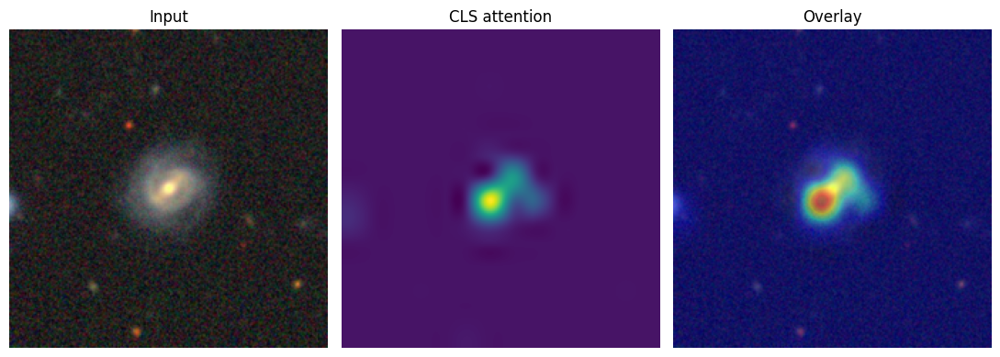

In [43]:
#@title Attention rollout (CLS → patches) + overlay
#Tokens gossip: every patch weighs every other patch using similarity. The CLS token listens to everyone, then summarizes.
def attention_rollout(x_tensor):
    model.eval()
    with torch.no_grad():
        logits, attn_maps = model(x_tensor.unsqueeze(0).to(device), return_attn_maps=True)
    if not attn_maps:
        return None
    R = None
    for A in attn_maps:                 # list of (B, heads, T, T)
        A = A.mean(dim=1)[0]            # average heads → (T, T)
        A = A + torch.eye(A.size(-1), device=A.device)
        A = A / A.sum(dim=-1, keepdim=True)
        R = A if R is None else R @ A
    cls_to_patches = R[0, 1:]           # skip CLS→CLS
    return cls_to_patches               # vector of length N

x, _ = val_ds[0]
vec = attention_rollout(x)
if vec is not None:
    grid = int(math.sqrt(vec.numel()))
    attn_grid = vec.reshape(grid, grid).detach().cpu().numpy()
    attn_up = cv2.resize(attn_grid, (IMG_SIZE, IMG_SIZE), interpolation=cv2.INTER_CUBIC)
    attn_up = (attn_up - attn_up.min())/(attn_up.max()-attn_up.min()+1e-8)

    base = (inv(x).permute(1,2,0).clamp(0,1)).numpy()
    fig, axs = plt.subplots(1,3, figsize=(11,4))
    axs[0].imshow(base); axs[0].set_title("Input"); axs[0].axis('off')
    axs[1].imshow(attn_up, cmap='viridis'); axs[1].set_title("CLS attention"); axs[1].axis('off')
    axs[2].imshow(base); axs[2].imshow(attn_up, cmap='jet', alpha=0.45); axs[2].set_title("Overlay"); axs[2].axis('off')
    plt.tight_layout(); plt.show()
else:
    print("No attention maps captured.")


In [44]:
#@title Animation 2: attention rollout progression across layers (fixed for newer Matplotlib)
def rollout_sequence(x_tensor):
    model.eval()
    with torch.no_grad():
        logits, attn_maps = model(x_tensor.unsqueeze(0).to(device), return_attn_maps=True)
    outs = []
    if not attn_maps:
        return outs
    R = None
    for A in attn_maps:
        A = A.mean(dim=1)[0]                      # (T, T) avg over heads
        A = A + torch.eye(A.size(-1), device=A.device)
        A = A / A.sum(dim=-1, keepdim=True)
        R = A if R is None else R @ A
        cls_to_patches = R[0, 1:]
        g = int(math.sqrt(cls_to_patches.numel()))
        outs.append(cls_to_patches.reshape(g, g).detach().cpu().numpy())
    return outs

# Build the per-layer rollout sequence
x2, _ = val_ds[1]
seq = rollout_sequence(x2)

if seq:
    # base image (de-normalized)
    inv = transforms.Normalize(mean=[-1, -1, -1], std=[2, 2, 2])
    base = (inv(x2).permute(1, 2, 0).clamp(0, 1)).numpy()

    # Prepare figure with two persistent image artists:
    #   1) the base galaxy image
    #   2) an overlay whose data we update per frame
    fig, ax = plt.subplots(figsize=(5, 5))
    ax.set_axis_off()

    base_im = ax.imshow(base)
    # initialize overlay with zeros; we'll update its data in animate()
    overlay_im = ax.imshow(np.zeros((IMG_SIZE, IMG_SIZE)),
                           cmap='jet', alpha=0.45, vmin=0.0, vmax=1.0)

    def init():
        overlay_im.set_data(np.zeros((IMG_SIZE, IMG_SIZE)))
        overlay_im.set_alpha(0.0)  # hide at first frame
        return [base_im, overlay_im]

    def animate(i):
        attn = seq[i]
        attn_up = cv2.resize(attn, (IMG_SIZE, IMG_SIZE), interpolation=cv2.INTER_CUBIC)
        attn_up = (attn_up - attn_up.min()) / (attn_up.max() - attn_up.min() + 1e-8)
        overlay_im.set_data(attn_up)
        overlay_im.set_alpha(0.45)  # show overlay
        return [base_im, overlay_im]

    ani2 = animation.FuncAnimation(fig, animate, init_func=init,
                                   frames=len(seq), interval=350, blit=True)
    plt.close(fig)

    from IPython.display import HTML
    HTML(ani2.to_jshtml())
else:
    print("Could not produce attention sequence.")


### What the axes represent

* **Rows** → True classes (what the data actually is)
* **Columns** → Predicted classes (what the model guessed)

Example format:

|              | Predicted Class A | Predicted Class B |
| ------------ | ----------------- | ----------------- |
| True Class A | correct           | misclassified     |
| True Class B | misclassified     | correct           |


### The diagonal is what you want

Cells on the **main diagonal** represent correctly classified samples.
High values along that diagonal indicate a good model.

If the diagonal values are low → the model is struggling.


### Off-diagonal numbers reveal mistakes

Each non-diagonal cell tells you *how many times* the model confused one class with another.

Example:

* If many **True Class A** are predicted as **Class B**, the model can’t differentiate them.
* This suggests those two categories may look similar or the model lacks discriminative features.


### What to look for

| Pattern                                        | Interpretation                                                                                  |
| ---------------------------------------------- | ----------------------------------------------------------------------------------------------- |
| Most values concentrated on diagonal           | Model performs well overall                                                                     |
| Pattern of confusions between specific classes | Model struggles to separate those classes → actionable insight                                  |
| Entire row misclassified                       | Model doesn’t learn this class well (needs more training data, augmentation, or model capacity) |
| Entire column ≈ 0                              | Model rarely predicts that class (possibly underrepresented in training)                        |

### Derived metrics from a confusion matrix

You can compute:

* **Accuracy**: % of all correct predictions
* **Precision** (per class): How often predicted class was correct
* **Recall** (per class): How often actual samples were found correctly
* **F1** score: Balance between precision and recall

These metrics show whether errors are due to:

* Overprediction of some classes
* Missing rare classes
* General confusion across all classes

### The matrix tells a *story*

A confusion matrix does not just score performance
It **explains the strengths and weaknesses** of a classifier.

Examples in astronomy:

* Spirals misclassified as irregular → lack of clear features
* Edge-on vs face-on spirals confusion → projection effect
* Barred vs unbarred confusion → bars may be faint

### Bottom line

A good confusion matrix:

* Strong diagonal
* Few structured off-diagonal errors
* Balanced recognition across all classes

A bad confusion matrix:

* Weak diagonal
* Heavy confusions in specific areas (model blind spots) 
* Rows/columns dominated by zeros (bias / class imbalance)


                       precision    recall  f1-score   support

            Disturbed      0.377     0.215     0.274       107
              Merging      0.704     0.597     0.646       211
         Round Smooth      0.833     0.810     0.821       252
  Cigar Shaped Smooth      0.773     0.789     0.781       194
        Barred Spiral      0.537     0.579     0.557        38
Unbarred Tight Spiral      0.593     0.670     0.629       209
Unbarred Loose Spiral      0.546     0.543     0.545       184
     Edge-on w/ Bulge      0.492     0.551     0.520       272
    Edge-on w/o Bulge      0.735     0.878     0.800       139
            Irregular      0.825     0.786     0.805       168

             accuracy                          0.661      1774
            macro avg      0.641     0.642     0.638      1774
         weighted avg      0.658     0.661     0.657      1774



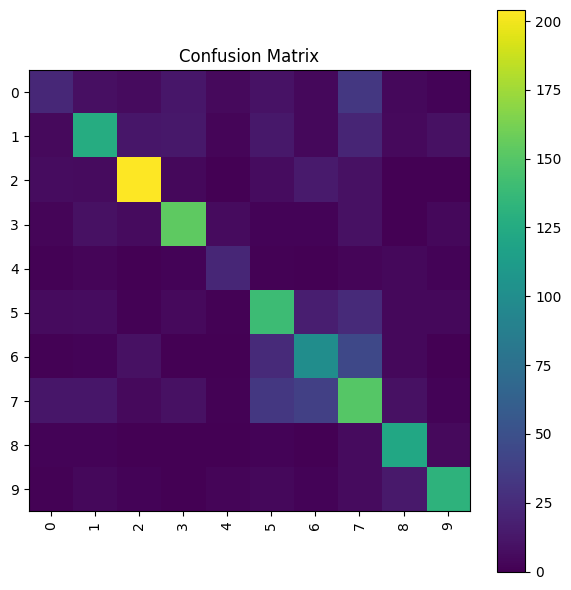

In [45]:
#@title Quick evaluation (report & confusion matrix)
from sklearn.metrics import classification_report, confusion_matrix

all_preds, all_true = [], []
model.eval()
with torch.no_grad():
    for x, y in tqdm(val_dl, leave=False):
        x = x.to(device)
        logits = model(x)
        preds = logits.argmax(1).cpu().numpy()
        all_preds.extend(preds.tolist())
        all_true.extend(list(y))

print(classification_report(all_true, all_preds, target_names=CLASSES, digits=3))

cm = confusion_matrix(all_true, all_preds)
plt.figure(figsize=(6,6))
plt.imshow(cm, interpolation='nearest')
plt.title("Confusion Matrix")
plt.colorbar(); plt.xticks(range(10), rotation=90); plt.yticks(range(10))
plt.tight_layout(); plt.show()
